In [1]:
import numpy as np
import pandas as pd

In [2]:
import struct
import os

import struct

def read_jet_db_file(file_path):
    with open(file_path, 'rb') as f:
        # Read the file header
        header = f.read(20)
        
        # Extract information from the header
        version = struct.unpack('<H', header[:2])[0]
        file_type = header[4:20].decode('ascii')
        
        # Read the rest of the file
        data = f.read()
        
        # For demonstration purposes, we'll just count the number of non-zero bytes
        non_zero_bytes = sum(1 for byte in data if byte != 0)
    
    return {
        'version': version,
        'file_type': file_type,
        'non_zero_bytes': non_zero_bytes,
        'raw_data': data
    }

# Usage


# Usage
folder = r'C:\Users\jc2713\OneDrive - Imperial College London (1)\Tohoku - pump priming\Data\Milling'
file_path = '20241015 163420 Co-Pt-Al-Ta-Si-new-avdbTF-111024-5x.qmp'
path = os.path.join(folder, file_path)
result = read_jet_db_file(path)

print(f"File version: {result['version']}")
print(f"Timestamp: {result['file_type']}")
print(f"Data: {result['non_zero_bytes']}")
# print(f"Raw data: {result['raw_data']}")
# print(f"Number of data points: {len(result['non_zero_bytes'])}")
# print(f"First few data points: {result['non_zero_bytes'][:5]}")


File version: 256
Timestamp: Standard Jet DB 
Data: 3402180
Raw data: b'\x01\x00\x00\x00\xb5n\x03b`\t\xc2U\xe9\xa9gr@?\x00\x9c~\x9f\x90\xff\x85\x9a1\xc5y\xba\xed0\xbc\xdf\xcc\x9dc\xd9\xe4\xc3\x9fF\xfb\x8a\xbcN\x8aI\xec7Q\xf6\x9c\xfa\xca\xec(\xe6\x1f\x04\x8a`X&{6\xf9\xc0\xdf\xb1{F\x13C\xc3\x1d\xb138\xd3y[\x9e\x07|* \xd7|\x99\x08\x1f\x98\xfd\xf7\x006\x80\xfa\x7f\x86f_\x95\xf8\xd0\x89$\x85g\xc6\x1f\'D\xd2\xee\xcfe\xed\xff\x07\xc7F\xa1x\x16\x0c\xed\xe9-b\xd4T\x06\x00\x004.0\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x

In [6]:
import os
import struct

def read_jet_db_file(file_path):
    with open(file_path, 'rb') as f:
        # Convert hex string to bytes
        f_read = f.read()
        print(f_read[:100])
        file_bytes = bytes.fromhex(f_read.replace(' ', ''))
        
        # Read file signature
        signature = file_bytes[:16].decode('ascii').rstrip('\x00')
        
        # Read file version
        version = struct.unpack('<H', file_bytes[16:18])[0]
        
        # Read file type
        file_type = file_bytes[20:36].decode('ascii').rstrip('\x00')
        
        # Read database version
        db_version = file_bytes[148:152].decode('ascii').rstrip('\x00')
        
    return {
        'signature': signature,
        'version': version,
        'file_type': file_type,
        'db_version': db_version
    }

# Usage
folder = r'C:\Users\jc2713\OneDrive - Imperial College London (1)\Tohoku - pump priming\Data\Milling'
file_path = '20241015 163420 Co-Pt-Al-Ta-Si-new-avdbTF-111024-5x.qmp'
path = os.path.join(folder, file_path)
result = read_jet_db_file(path)

print(f"File version: {result['signature']}")
print(f"Timestamp: {result['version']}")
print(f"Data: {result['file_type']}")
print(f"Data: {result['db_version']}")

b'\x00\x01\x00\x00Standard Jet DB\x00\x01\x00\x00\x00\xb5n\x03b`\t\xc2U\xe9\xa9gr@?\x00\x9c~\x9f\x90\xff\x85\x9a1\xc5y\xba\xed0\xbc\xdf\xcc\x9dc\xd9\xe4\xc3\x9fF\xfb\x8a\xbcN\x8aI\xec7Q\xf6\x9c\xfa\xca\xec(\xe6\x1f\x04\x8a`X&{6\xf9\xc0\xdf\xb1{F\x13C\xc3\x1d\xb138\xd3'


TypeError: a bytes-like object is required, not 'str'

In [7]:
import spectrochempy as scp

folder = r'C:\Users\jc2713\OneDrive - Imperial College London (1)\Tohoku - pump priming\Data\Milling'
file_path = '20241015 163420 Co-Pt-Al-Ta-Si-new-avdbTF-111024-5x.asc'
path = os.path.join(folder, file_path)
# Read the Quadera file
dataset = scp.read_quadera(path)

# Access the data
print(dataset)

"<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAABgAAAAYCAYAAADgdz34AAAAAXNSR0IArs4c6QAAAAlw SFlzAAAJOgAACToB8GSSSgAAAetpVFh0WE1MOmNvbS5hZG9iZS54bXAAAAAAADx4OnhtcG1ldGEgeG1sbnM6eD0iYWRvYmU6bnM6 bWV0YS8iIHg6eG1wdGs9IlhNUCBDb3JlIDUuNC4wIj4KICAgPHJkZjpSREYgeG1sbnM6cmRmPSJodHRwOi8vd3d3LnczLm9yZy8x OTk5LzAyLzIyLXJkZi1zeW50YXgtbnMjIj4KICAgICAgPHJkZjpEZXNjcmlwdGlvbiByZGY6YWJvdXQ9IiIKICAgICAgICAgICAg eG1sbnM6eG1wPSJodHRwOi8vbnMuYWRvYmUuY29tL3hhcC8xLjAvIgogICAgICAgICAgICB4bWxuczp0aWZmPSJodHRwOi8vbnMu YWRvYmUuY29tL3RpZmYvMS4wLyI+CiAgICAgICAgIDx4bXA6Q3JlYXRvclRvb2w+bWF0cGxvdGxpYiB2ZXJzaW9uIDIuMS4wLCBo dHRwOi8vbWF0cGxvdGxpYi5vcmcvPC94bXA6Q3JlYXRvclRvb2w+CiAgICAgICAgIDx0aWZmOk9yaWVudGF0aW9uPjE8L3RpZmY6 T3JpZW50YXRpb24+CiAgICAgIDwvcmRmOkRlc2NyaXB0aW9uPgogICA8L3JkZjpSREY+CjwveDp4bXBtZXRhPgqNQaNYAAAGiUlE QVRIDY1We4xU1Rn/3XPuYx47u8w+hnU38hTcuoUEt/6D2y4RB0ME1BoEd9taJaKh9CFiN7YGp7appUAMNmktMZFoJTYVLVQ0smsy 26CN0SU1QgsuFAaW3WVmx33N677O6XfuyoIxTXqSO/fec+75fd93vt/3/UbDV0aKSZmCpkFMLz3T9utuu2N+o98aDSMBKVAo89z5 y+zEz3ZafcCOfvWdlGCalqKn1Bf71CygTd+mf1esSOnpdMpTb+vWpTZuWVfe3jLPa5tzHYNm0T5N0gpdkkHaDBeGBU6d1/t/fyS8 +/CbqdfUvmsx1PuMgc2bNxv79u1zgd31r+7JH1jbIZKxWRXAcYUQ8IWvBfBXNjEuJWPgMA02NR7C3/pYT9fjdZ3A9tGrWF8YSJHn qcDz3y7q2T967PZv+gnYJdd1mEZ+62zGDQV/dQgKhmLzDNOXCEWM3j6eTT5Y3w78dOBKJLR1PQf+4ivPj76UPZnssBN+wbM9Aet/ AV81Mf1EEULXYfOobvX2WWQk0aoioXwwSmirOlioY0mu8BIouzYl7P8GV3vpqCCEZvlFz769w08oLDWvyKIyL1asSm28d6WfzA97 ztvvV1kexUMsmhlkULEkuGYmFYC6AvfUrITnwUKl5K79lkjeSSRRTCTbQPd95e1WzMbZSya74XoXAxctCllCnbECMOjZNGRwvzIX nD85wbkMmKK+U045Dtdi8Qp+SAxU2GTg2bYlC9224pgvmSb54vkVTBQYyhUt2KjAMyMmPjwRQW5Mh2WKwJhlBh6jVGagFM84wZnQ 4bpC0Rt4pk1PbSt0NDcxDA5xryosDHWgtbM0DGZDWLSoiDMDYeQnGVrmOThxLozB0RAaahzkJzjKNqcIQBymJFMkOlN8Dqjpg0XY Tx5xO/QbmmUrqIjGJznq47TqTaClKYfjp+PInLMwnOdYvtQBZ2XcunQY+VwIo4U4muoFEjVEFE6lQyEUKzHYfgQG9ylCyngU+Cxj tOqxCDGHcCsOMCs6iQul5ZiStdATYxjMZXDLTUVwLY8Jey4uOh2IxjwsrP8UXJYxUrkZrghBahzV5iXU6gNkq0Z1EzIsUBUSCV2n EOHo0LVxHCpuxabJJdhi5PFnvw5vLXwXIfNZvD/+JNo/X40NegE54sUaazl+UL8XD1x+FB9Ijjt4EQfdGN6J/x131LwIV9ap/AYs 0x1fz1ZKFbh6A7qKy/By9Dg6G36Ep91vUJJ15Cqr0Z67E8/HzmBrw1OwxWyM+3Mo6BAuSB17oyfx0Oyl2DN0Hqs/70Cx6hBCvESF UY1ShWXZZEE7OTAYxZzaPH4TuoiusZvRnunFy2NbiHYuBp2vB66srX4vMEjpRKPxKXmnoQ4+Mn4DPiv8CYcrs3GfNUXJLtM+alSO hrMj/KT+wBNW3+E/2liywNO3iSflbaFva/+stGDTxE0E9Sjaox8HBhxpEamzMGSEaFKg+mjEddzDh1MxTDq3YV1kGBsjfwW3S9Cq anjmko+ndlb1UR3s6K8JlfphNWq9Ew/7c61T2BB/EbcaNkb8GBaE0tANH7/M34PLdhJDzjIcL9xPbdTG6zyM72Y+wXPHmvB489No fm0b5HnbQ9Rgp/7DSSd29AeVvPeNyK6JcYl/yQVi5dBjuGvoV/gaJe47s45QUxrDmcYX0MBsdF7egvXZ7+O0vZA4X8QmOQWjlSK7 RDz5wIM30gp9UbWcGjXxhzdDu1SiNSpx6kcQB57rPnr/3dlkZarWLnlRq5oPET1dOCIOk4wALib9eeS5iygfhkd09H0DWphB/+gs +PcOAS+ssrFmmXXgVfR0de9cpbAJfH3Q1jofW9DZk56dDcVsq9YcsoUMEd1qyLoT3BX1YiyHMJuk97hyjqIoE91t+NcTLeN0ZrfM oXatZbu6G0h4VG+ibqq0IJVK6cAjo6serG3vSUezCMct0yQeSOFJSUImqb2qbknUpDqlZxE0QZ+ZUpSlZx79h4Nda6zef9dlk121 JDjbR5XggPRZlRnS6bRQRtLpn4++cuie/Yvn2svmNxuLw9WCcYIl4fEoTEGiSTUqJdfgU+8ROqf1iMkLzS389YtNPXc/PH8l8ONB JZkHD+4JtD04HmVEDWWErmBhzV2/2LB1bemJG6krzv2S6NOHUgtEP0Oif5pE/3fHoruP7N8RiP61GArzSwbUhJJQpXJKiKbfr/3b IhKq76sKPUdF9NW/LSqfSn6vjv8C45H/6FSgvZQAAAAASUVORK5CYII=' style='height:25px; border-radius:12px; display:inline-block; float:left; vertical-align:middle'>",SpectroChemPy's API - v.0.6.9© Copyright 2014-2024 - A.Travert & C.Fernandez @ LCS


FileNotFoundError: 

 WARNING | (ParserWarning) Length of header or names does not match length of data. This leads to a loss of data with index_col=False.


['0_Time', '0_Time Relative [s]', 'Al-27 Ion Count [cps]', '1_Time', '1_Time Relative [s]', 'Si-28 Ion Count [cps]', '2_Time', '2_Time Relative [s]', 'Co-59 Ion Count [cps]', '3_Time', '3_Time Relative [s]', 'Ta-181 Ion Count [cps]', '4_Time', '4_Time Relative [s]', 'Pt-195 Ion Count [cps]', '5_Unnamed: 15_level_1']
{'Sourcefile': '20241015 163420 Co-Pt-Al-Ta-Si-new-avdbTF-111024-5x.qmp', 'Exporttime': '2024/10/16 12:32:58', 'Start Time': '2024/10/15 16:35:55'}
                  0_Time  0_Time Relative [s]  Al-27 Ion Count [cps]  \
0    2024/10/15 16:35:55                0.000               19.99909   
1    2024/10/15 16:36:03                7.515                0.00000   
2    2024/10/15 16:36:04                8.720                0.00000   
3    2024/10/15 16:36:05                9.926                0.00000   
4    2024/10/15 16:36:06               11.132            10949.60000   
..                   ...                  ...                    ...   
381  2024/10/15 16:43:41      

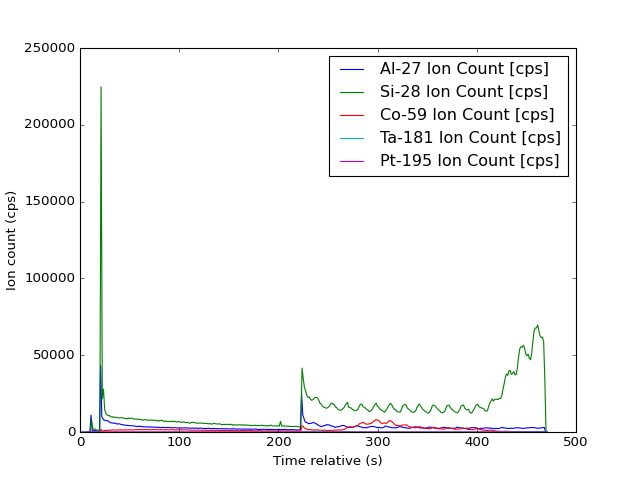

In [25]:
import pandas as pd
import io

def read_asc_file(file_path):
    # Initialize variables
    metadata = {}
    
    # Read metadata
    with open(file_path, 'r') as file:
        for _ in range(4):  # Read the first 4 lines for metadata
            line = file.readline().strip()
            if line:
                key, value = line.split('\t', 1)
                metadata[key] = value
    
    # Read the data with multi-index header
    data = pd.read_csv(file_path, sep='\t', header=[1,2], skiprows=4)
    # Combine the multi-index header into a single header
    new_columns = []
    count = 0
    for col in data.columns:
        if 'Unnamed:' in col[0]:#pd.isna(col[0]) or col[0] == '':
            new_columns.append(f"{count}_{col[1]}")
        else:
            new_columns.append(f"{col[0]} {col[1]}")
            count+=1
    print(new_columns)
    data.columns = new_columns
    
    # Combine the multi-index header into a single header
    
    return data, metadata

# Usage example:
folder = r'C:\Users\jc2713\OneDrive - Imperial College London (1)\Tohoku - pump priming\Data\Milling'
file_path = '20241015 163420 Co-Pt-Al-Ta-Si-new-avdbTF-111024-5x.asc'
path = os.path.join(folder, file_path)

data, metadata = read_asc_file(path)

#print(metadata)
#print(data)

import matplotlib.pyplot as plt

fig,ax = plt.subplots(1,1)

def plot_ioncount(data, ax, x_l, y_l):
    ax.plot(data[x_l], data[y_l], label = y_l)

plot_ioncount(data,ax,'0_Time Relative [s]','Al-27 Ion Count [cps]')
plot_ioncount(data,ax,'2_Time Relative [s]','Si-28 Ion Count [cps]')
plot_ioncount(data,ax,'2_Time Relative [s]','Co-59 Ion Count [cps]')
plot_ioncount(data,ax,'3_Time Relative [s]','Ta-181 Ion Count [cps]')
plot_ioncount(data,ax,'4_Time Relative [s]','Pt-195 Ion Count [cps]')

ax.legend()
ax.set_xlabel('Time relative (s)')
ax.set_ylabel('Ion count (cps)')
plt.show()


In [ ]:
import pandas as pd
import io

def read_asc_file(file_path):
    # Initialize variables
    metadata = {}
    
    # Read metadata
    with open(file_path, 'r') as file:
        for _ in range(4):  # Read the first 4 lines for metadata
            line = file.readline().strip()
            if line:
                key, value = line.split('\t', 1)
                metadata[key] = value
    
    # Read the data with multi-index header
    data = pd.read_csv(file_path, sep='\t', header=[1,2], skiprows=4)
    # Combine the multi-index header into a single header
    new_columns = []
    count = 0
    for col in data.columns:
        if 'Unnamed:' in col[0]:#pd.isna(col[0]) or col[0] == '':
            new_columns.append(f"{count}_{col[1]}")
        else:
            new_columns.append(f"{col[0]} {col[1]}")
            count+=1
    print(new_columns)
    data.columns = new_columns
    
    # Combine the multi-index header into a single header
    
    return data, metadata

# Usage example:
folder = r'C:\Users\jc2713\OneDrive - Imperial College London (1)\Tohoku - pump priming\Data\Milling'
file_path = '20241015 163420 Co-Pt-Al-Ta-Si-new-avdbTF-111024-5x.asc'
path = os.path.join(folder, file_path)

data, metadata = read_asc_file(path)

#print(metadata)
#print(data)

import matplotlib.pyplot as plt

fig,ax = plt.subplots(1,1)

def plot_ioncount(data, ax, x_l, y_l):
    ax.plot(data[x_l], data[y_l], label = y_l)

plot_ioncount(data,ax,'0_Time Relative [s]','Al-27 Ion Count [cps]')
plot_ioncount(data,ax,'2_Time Relative [s]','Si-28 Ion Count [cps]')
plot_ioncount(data,ax,'2_Time Relative [s]','Co-59 Ion Count [cps]')
plot_ioncount(data,ax,'3_Time Relative [s]','Ta-181 Ion Count [cps]')
plot_ioncount(data,ax,'4_Time Relative [s]','Pt-195 Ion Count [cps]')

ax.legend()
ax.set_xlabel('Time relative (s)')
ax.set_ylabel('Ion count (cps)')
plt.show()
